Introduction

In today's digital era, the popularity of online news articles is shaped by various factors, including content type, word count, publication timing, and social media engagement. For digital media companies, understanding what drives an article's popularity is crucial for creating compelling content and enhancing social media presence. Keywords, images, publication day, and social media interactions significantly impact an article's success. Researchers are continuously exploring additional features to predict the popularity of online news articles with greater accuracy.

Aim

The goal of this project is to uncover and analyze the key factors that influence the popularity of online news articles. By leveraging machine learning models, we aim to enhance the accuracy of these predictions, providing valuable insights for media companies to optimize their content strategies.

OnlineNewsPopularity___ Project 

Setting Up Your Data Analysis Environment: Importing Key Python Libraries

In [52]:
import pandas as pd  # Data Manipulation and Analysis
import matplotlib    #  Comprehensive Library for Creating Static, Animated, and Interactive Visualizations
import matplotlib.pyplot as plt  # High-Level Interface for Interactive Visualizations
import plotly.express as px
import seaborn as sns # Statistical Data Visualization Based on Matplotlib
import numpy as np    #  Fundamental Package for Numerical Computing 
from sklearn import preprocessing  # Scikit-Learn (Preprocessing): Preprocessing Utilities for Machine Learning
from sklearn.model_selection import train_test_split  #
import os  # Operating System Interfaces

In [53]:
# handle all feature 
pd.set_option('display.max_columns', None)

In [54]:
# check the path
os.getcwd()

'C:\\Users\\Startklar\\DATA\\ML project 3'

In [55]:
# data processing, CSV file I/O (e.g. pd.read_csv)
data=pd.read_csv(r"C:\Users\Startklar\DATA\ML project 3\Dataset1\OnlineNewsPopularity2.csv")


In [56]:
missing_values = ["n/a", "na", "--","-"]

In [57]:
# Exploratory Data Analysis
# checking the top 5 records of the data to understand how it looks like
data.head(5)

,url,timedelta,n_tokens_title,n_tokens_content,n_unique_tokens,n_non_stop_words,n_non_stop_unique_tokens,num_hrefs,num_self_hrefs,num_imgs,num_videos,average_token_length,num_keywords,data_channel_is_lifestyle,data_channel_is_entertainment,data_channel_is_bus,data_channel_is_socmed,data_channel_is_tech,data_channel_is_world,kw_min_min,kw_max_min,kw_avg_min,kw_min_max,kw_max_max,kw_avg_max,kw_min_avg,kw_max_avg,kw_avg_avg,self_reference_min_shares,self_reference_max_shares,self_reference_avg_sharess,weekday_is_monday,weekday_is_tuesday,weekday_is_wednesday,weekday_is_thursday,weekday_is_friday,weekday_is_saturday,weekday_is_sunday,is_weekend,LDA_00,LDA_01,LDA_02,LDA_03,LDA_04,global_subjectivity,global_sentiment_polarity,global_rate_positive_words,global_rate_negative_words,rate_positive_words,rate_negative_words,avg_positive_polarity,min_positive_polarity,max_positive_polarity,avg_negative_polarity,min_negative_polarity,max_negative_polarity,title_subjectivity,title_sentiment_polarity,abs_title_subjectivity,abs_title_sentiment_polarity,shares
0,http://mashable.com/2013/01/07/amazon-instant-...,731.0,12.0,219.0,0.663594,1.0,0.815385,4.0,2.0,1.0,0.0,4.680365,5.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,496.0,496.0,496.000000,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.500331,0.378279,0.040005,0.041263,0.040123,0.521617,0.092562,0.045662,0.013699,0.769231,0.230769,0.378636,0.100000,0.7,-0.350000,-0.600,-0.200000,0.500000,-0.187500,0.000000,0.187500,593
1,http://mashable.com/2013/01/07/ap-samsung-spon...,731.0,9.0,255.0,0.604743,1.0,0.791946,3.0,1.0,1.0,0.0,4.913725,4.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.799756,0.050047,0.050096,0.050101,0.050001,0.341246,0.148948,0.043137,0.015686,0.733333,0.266667,0.286915,0.033333,0.7,-0.118750,-0.125,-0.100000,0.000000,0.000000,0.500000,0.000000,711
2,http://mashable.com/2013/01/07/apple-40-billio...,731.0,9.0,211.0,0.575130,1.0,0.663866,3.0,1.0,1.0,0.0,4.393365,6.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,918.0,918.0,918.000000,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.217792,0.033334,0.033351,0.033334,0.682188,0.702222,0.323333,0.056872,0.009479,0.857143,0.142857,0.495833,0.100000,1.0,-0.466667,-0.800,-0.133333,0.000000,0.000000,0.500000,0.000000,1500
3,http://mashable.com/2013/01/07/astronaut-notre...,731.0,9.0,531.0,0.503788,1.0,0.665635,9.0,0.0,1.0,0.0,4.404896,7.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.028573,0.419300,0.494651,0.028905,0.028572,0.429850,0.100705,0.041431,0.020716,0.666667,0.333333,0.385965,0.136364,0.8,-0.369697,-0.600,-0.166667,0.000000,0.000000,0.500000,0.000000,1200
4,http://mashable.com/2013/01/07/att-u-verse-apps/,731.0,13.0,1072.0,0.415646,1.0,0.540890,19.0,19.0,20.0,0.0,4.682836,7.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,545.0,16000.0,3151.157895,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.028633,0.028794,0.028575,0.028572,0.885427,0.513502,0.281003,0.074627,0.012127,0.860215,0.139785,0.411127,0.033333,1.0,-0.220192,-0.500,-0.050000,0.454545,0.136364,0.045455,0.136364,505


In [58]:
# I am creating multiple copies of data to not disturb the original dataset and use them as and when required.
df1=data.copy()

In [59]:
df2=data.copy()

In [60]:
df1.head()

,url,timedelta,n_tokens_title,n_tokens_content,n_unique_tokens,n_non_stop_words,n_non_stop_unique_tokens,num_hrefs,num_self_hrefs,num_imgs,num_videos,average_token_length,num_keywords,data_channel_is_lifestyle,data_channel_is_entertainment,data_channel_is_bus,data_channel_is_socmed,data_channel_is_tech,data_channel_is_world,kw_min_min,kw_max_min,kw_avg_min,kw_min_max,kw_max_max,kw_avg_max,kw_min_avg,kw_max_avg,kw_avg_avg,self_reference_min_shares,self_reference_max_shares,self_reference_avg_sharess,weekday_is_monday,weekday_is_tuesday,weekday_is_wednesday,weekday_is_thursday,weekday_is_friday,weekday_is_saturday,weekday_is_sunday,is_weekend,LDA_00,LDA_01,LDA_02,LDA_03,LDA_04,global_subjectivity,global_sentiment_polarity,global_rate_positive_words,global_rate_negative_words,rate_positive_words,rate_negative_words,avg_positive_polarity,min_positive_polarity,max_positive_polarity,avg_negative_polarity,min_negative_polarity,max_negative_polarity,title_subjectivity,title_sentiment_polarity,abs_title_subjectivity,abs_title_sentiment_polarity,shares
0,http://mashable.com/2013/01/07/amazon-instant-...,731.0,12.0,219.0,0.663594,1.0,0.815385,4.0,2.0,1.0,0.0,4.680365,5.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,496.0,496.0,496.000000,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.500331,0.378279,0.040005,0.041263,0.040123,0.521617,0.092562,0.045662,0.013699,0.769231,0.230769,0.378636,0.100000,0.7,-0.350000,-0.600,-0.200000,0.500000,-0.187500,0.000000,0.187500,593
1,http://mashable.com/2013/01/07/ap-samsung-spon...,731.0,9.0,255.0,0.604743,1.0,0.791946,3.0,1.0,1.0,0.0,4.913725,4.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.799756,0.050047,0.050096,0.050101,0.050001,0.341246,0.148948,0.043137,0.015686,0.733333,0.266667,0.286915,0.033333,0.7,-0.118750,-0.125,-0.100000,0.000000,0.000000,0.500000,0.000000,711
2,http://mashable.com/2013/01/07/apple-40-billio...,731.0,9.0,211.0,0.575130,1.0,0.663866,3.0,1.0,1.0,0.0,4.393365,6.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,918.0,918.0,918.000000,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.217792,0.033334,0.033351,0.033334,0.682188,0.702222,0.323333,0.056872,0.009479,0.857143,0.142857,0.495833,0.100000,1.0,-0.466667,-0.800,-0.133333,0.000000,0.000000,0.500000,0.000000,1500
3,http://mashable.com/2013/01/07/astronaut-notre...,731.0,9.0,531.0,0.503788,1.0,0.665635,9.0,0.0,1.0,0.0,4.404896,7.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.028573,0.419300,0.494651,0.028905,0.028572,0.429850,0.100705,0.041431,0.020716,0.666667,0.333333,0.385965,0.136364,0.8,-0.369697,-0.600,-0.166667,0.000000,0.000000,0.500000,0.000000,1200
4,http://mashable.com/2013/01/07/att-u-verse-apps/,731.0,13.0,1072.0,0.415646,1.0,0.540890,19.0,19.0,20.0,0.0,4.682836,7.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,545.0,16000.0,3151.157895,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.028633,0.028794,0.028575,0.028572,0.885427,0.513502,0.281003,0.074627,0.012127,0.860215,0.139785,0.411127,0.033333,1.0,-0.220192,-0.500,-0.050000,0.454545,0.136364,0.045455,0.136364,505


In [61]:
# to check the no. of rows and columns
df1.shape

(39644, 61)

In [62]:
# to check the statistics of the project
df1.describe()

,timedelta,n_tokens_title,n_tokens_content,n_unique_tokens,n_non_stop_words,n_non_stop_unique_tokens,num_hrefs,num_self_hrefs,num_imgs,num_videos,average_token_length,num_keywords,data_channel_is_lifestyle,data_channel_is_entertainment,data_channel_is_bus,data_channel_is_socmed,data_channel_is_tech,data_channel_is_world,kw_min_min,kw_max_min,kw_avg_min,kw_min_max,kw_max_max,kw_avg_max,kw_min_avg,kw_max_avg,kw_avg_avg,self_reference_min_shares,self_reference_max_shares,self_reference_avg_sharess,weekday_is_monday,weekday_is_tuesday,weekday_is_wednesday,weekday_is_thursday,weekday_is_friday,weekday_is_saturday,weekday_is_sunday,is_weekend,LDA_00,LDA_01,LDA_02,LDA_03,LDA_04,global_subjectivity,global_sentiment_polarity,global_rate_positive_words,global_rate_negative_words,rate_positive_words,rate_negative_words,avg_positive_polarity,min_positive_polarity,max_positive_polarity,avg_negative_polarity,min_negative_polarity,max_negative_polarity,title_subjectivity,title_sentiment_polarity,abs_title_subjectivity,abs_title_sentiment_polarity,shares
count,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000
mean,354.530471,10.398749,546.514731,0.548216,0.996469,0.689175,10.883690,3.293638,4.544143,1.249874,4.548239,7.223767,0.052946,0.178009,0.157855,0.058597,0.185299,0.212567,26.106801,1153.951682,312.366967,13612.354102,752324.066694,259281.938083,1117.146610,5657.211151,3135.858639,3998.755396,10329.212662,6401.697580,0.168020,0.186409,0.187544,0.183306,0.143805,0.061876,0.069039,0.130915,0.184599,0.141256,0.216321,0.223770,0.234029,0.443370,0.119309,0.039625,0.016612,0.682150,0.287934,0.353825,0.095446,0.756728,-0.259524,-0.521944,-0.107500,0.282353,0.071425,0.341843,0.156064,3395.380184
std,214.163767,2.114037,471.107508,3.520708,5.231231,3.264816,11.332017,3.855141,8.309434,4.107855,0.844406,1.909130,0.223929,0.382525,0.364610,0.234871,0.388545,0.409129,69.633215,3857.990877,620.783887,57986.029357,214502.129573,135102.247285,1137.456951,6098.871957,1318.150397,19738.670516,41027.576613,24211.332231,0.373889,0.389441,0.390353,0.386922,0.350896,0.240933,0.253524,0.337312,0.262975,0.219707,0.282145,0.295191,0.289183,0.116685,0.096931,0.017429,0.010828,0.190206,0.156156,0.104542,0.071315,0.247786,0.127726,0.290290,0.095373,0.324247,0.265450,0.188791,0.226294,11626.950749
min,8.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-1.000000,0.000000,-1.000000,0.000000,0.000000,0.000000,-1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-0.393750,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-1.000000,-1.000000,-1.000000,0.000000,-1.000000,0.000000,0.000000,1.000000
25%,164.000000,9.000000,246.000000,0.470870,1.000000,0.625739,4.000000,1.000000,1.000000,0.000000,4.478404,6.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-1.000000,445.000000,141.750000,0.000000,843300.000000,172846.875000,0.000000,3562.101631,2382.448566,639.000000,1100.000000,981.187500,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.025051,0.025012,0.028571,0.028571,0.0

In [63]:
# to check the number of missing values in each of the variables
df1.isnull().sum().values.any()

False

In [64]:
# Checking for Duplicate Values in the DataFrame.
df1[df1.duplicated()]

,url,timedelta,n_tokens_title,n_tokens_content,n_unique_tokens,n_non_stop_words,n_non_stop_unique_tokens,num_hrefs,num_self_hrefs,num_imgs,num_videos,average_token_length,num_keywords,data_channel_is_lifestyle,data_channel_is_entertainment,data_channel_is_bus,data_channel_is_socmed,data_channel_is_tech,data_channel_is_world,kw_min_min,kw_max_min,kw_avg_min,kw_min_max,kw_max_max,kw_avg_max,kw_min_avg,kw_max_avg,kw_avg_avg,self_reference_min_shares,self_reference_max_shares,self_reference_avg_sharess,weekday_is_monday,weekday_is_tuesday,weekday_is_wednesday,weekday_is_thursday,weekday_is_friday,weekday_is_saturday,weekday_is_sunday,is_weekend,LDA_00,LDA_01,LDA_02,LDA_03,LDA_04,global_subjectivity,global_sentiment_polarity,global_rate_positive_words,global_rate_negative_words,rate_positive_words,rate_negative_words,avg_positive_polarity,min_positive_polarity,max_positive_polarity,avg_negative_polarity,min_negative_polarity,max_negative_polarity,title_subjectivity,title_sentiment_polarity,abs_title_subjectivity,abs_title_sentiment_polarity,shares


In [65]:
# to check the duplicate values in each of the variables
df1.duplicated().sum()

0

<Axes: >

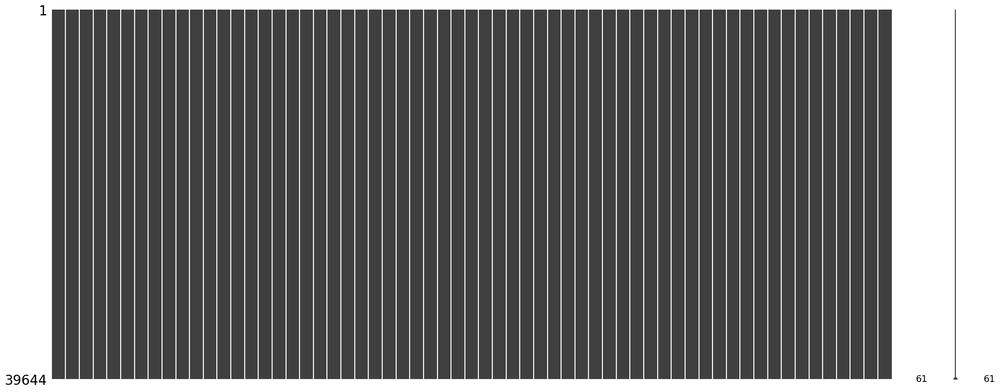

In [66]:
import missingno as msno # library to examine missing values
# creating matrix plot to see the pattern in missing values
msno.matrix(df1)

In [67]:
# drop the unwanted feature (category)
df1.drop(['url'], axis=1,inplace=True)

In [68]:
df1.head()

,timedelta,n_tokens_title,n_tokens_content,n_unique_tokens,n_non_stop_words,n_non_stop_unique_tokens,num_hrefs,num_self_hrefs,num_imgs,num_videos,average_token_length,num_keywords,data_channel_is_lifestyle,data_channel_is_entertainment,data_channel_is_bus,data_channel_is_socmed,data_channel_is_tech,data_channel_is_world,kw_min_min,kw_max_min,kw_avg_min,kw_min_max,kw_max_max,kw_avg_max,kw_min_avg,kw_max_avg,kw_avg_avg,self_reference_min_shares,self_reference_max_shares,self_reference_avg_sharess,weekday_is_monday,weekday_is_tuesday,weekday_is_wednesday,weekday_is_thursday,weekday_is_friday,weekday_is_saturday,weekday_is_sunday,is_weekend,LDA_00,LDA_01,LDA_02,LDA_03,LDA_04,global_subjectivity,global_sentiment_polarity,global_rate_positive_words,global_rate_negative_words,rate_positive_words,rate_negative_words,avg_positive_polarity,min_positive_polarity,max_positive_polarity,avg_negative_polarity,min_negative_polarity,max_negative_polarity,title_subjectivity,title_sentiment_polarity,abs_title_subjectivity,abs_title_sentiment_polarity,shares
0,731.0,12.0,219.0,0.663594,1.0,0.815385,4.0,2.0,1.0,0.0,4.680365,5.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,496.0,496.0,496.000000,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.500331,0.378279,0.040005,0.041263,0.040123,0.521617,0.092562,0.045662,0.013699,0.769231,0.230769,0.378636,0.100000,0.7,-0.350000,-0.600,-0.200000,0.500000,-0.187500,0.000000,0.187500,593
1,731.0,9.0,255.0,0.604743,1.0,0.791946,3.0,1.0,1.0,0.0,4.913725,4.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.799756,0.050047,0.050096,0.050101,0.050001,0.341246,0.148948,0.043137,0.015686,0.733333,0.266667,0.286915,0.033333,0.7,-0.118750,-0.125,-0.100000,0.000000,0.000000,0.500000,0.000000,711
2,731.0,9.0,211.0,0.575130,1.0,0.663866,3.0,1.0,1.0,0.0,4.393365,6.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,918.0,918.0,918.000000,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.217792,0.033334,0.033351,0.033334,0.682188,0.702222,0.323333,0.056872,0.009479,0.857143,0.142857,0.495833,0.100000,1.0,-0.466667,-0.800,-0.133333,0.000000,0.000000,0.500000,0.000000,1500
3,731.0,9.0,531.0,0.503788,1.0,0.665635,9.0,0.0,1.0,0.0,4.404896,7.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.028573,0.419300,0.494651,0.028905,0.028572,0.429850,0.100705,0.041431,0.020716,0.666667,0.333333,0.385965,0.136364,0.8,-0.369697,-0.600,-0.166667,0.000000,0.000000,0.500000,0.000000,1200
4,731.0,13.0,1072.0,0.415646,1.0,0.540890,19.0,19.0,20.0,0.0,4.682836,7.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,545.0,16000.0,3151.157895,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.028633,0.028794,0.028575,0.028572,0.885427,0.513502,0.281003,0.074627,0.012127,0.860215,0.139785,0.411127,0.033333,1.0,-0.220192,-0.500,-0.050000,0.454545,0.136364,0.045455,0.136364,505


In [69]:
# Strip leading and trailing spaces from column names
df1.columns = df1.columns.str.strip()

 Visualizing Data Distribution: Histograms for Numerical Columns

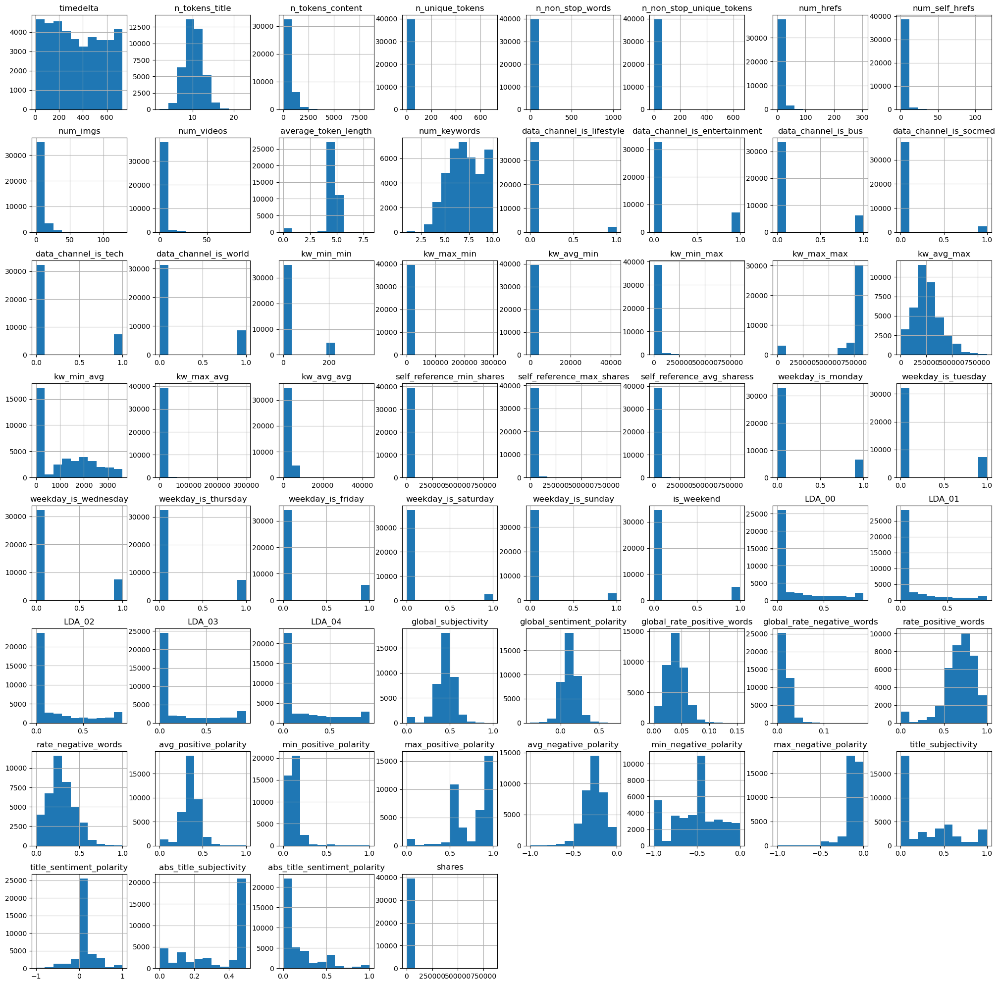

In [70]:
# for understanding the shape of the data distribution (e.g., normal, skewed, bimodal) 
# Generate histograms for each numerical column
df1.hist(figsize=(25,25))
plt.show()

# Scatter Plots of Features Against 'Shares': Visualizing Relationships

In [71]:
# The primary purpose of this code is to visualize the relationship between the 'shares' column and each other column in the DataFrame.
# Scatter plots are effective for spotting correlations, outliers, clusters, and trends between two variables

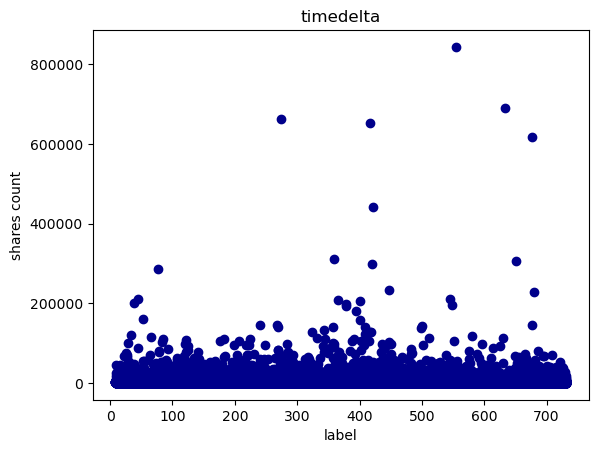

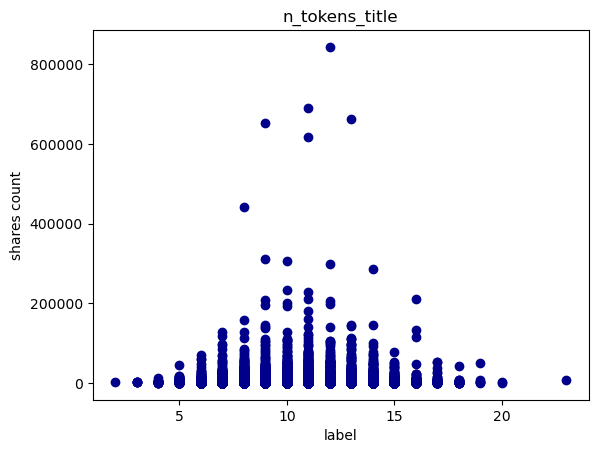

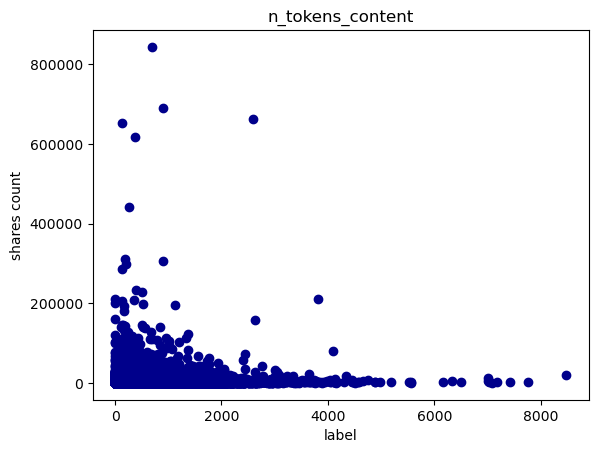

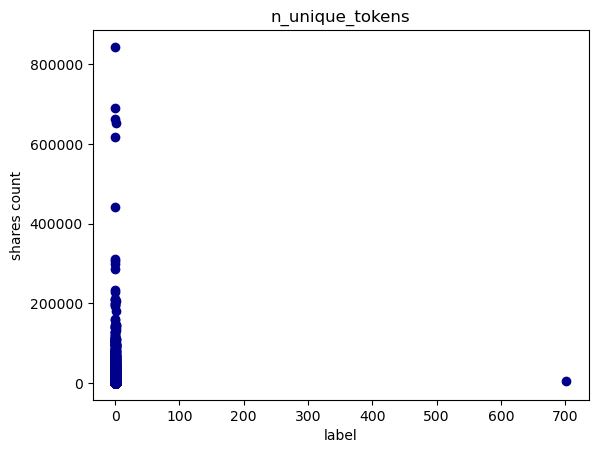

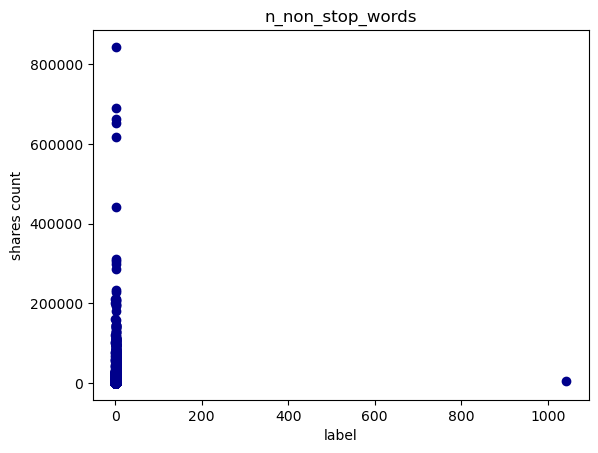

...

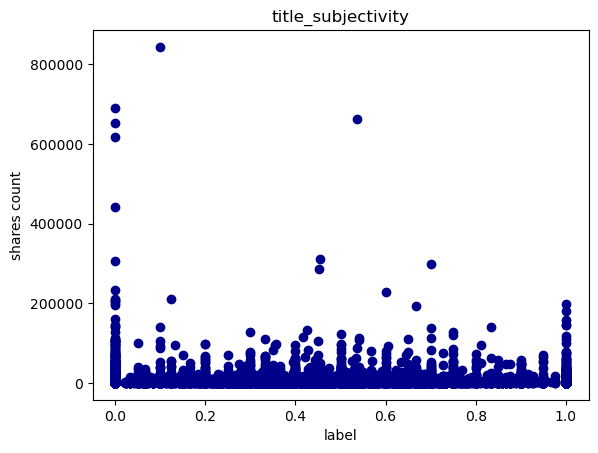

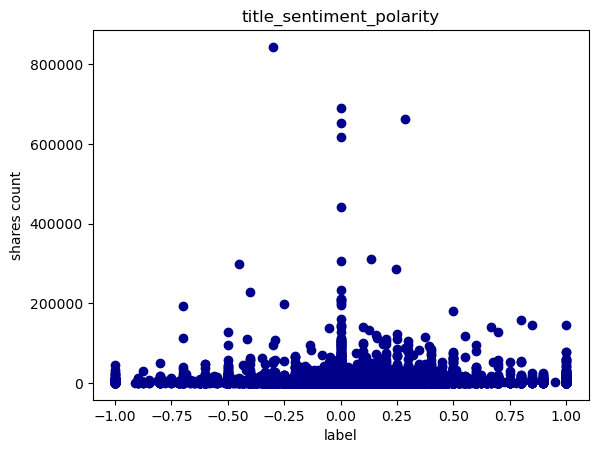

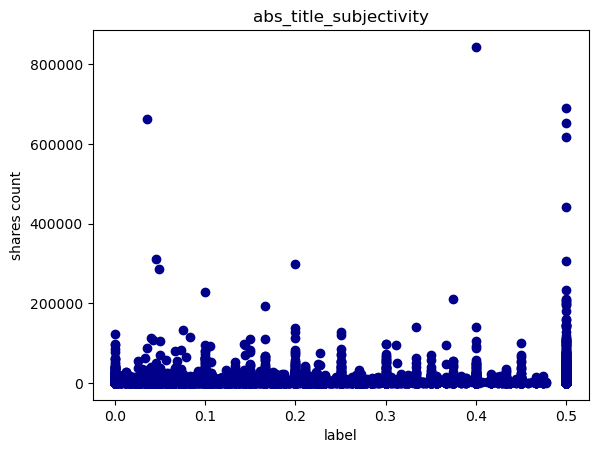

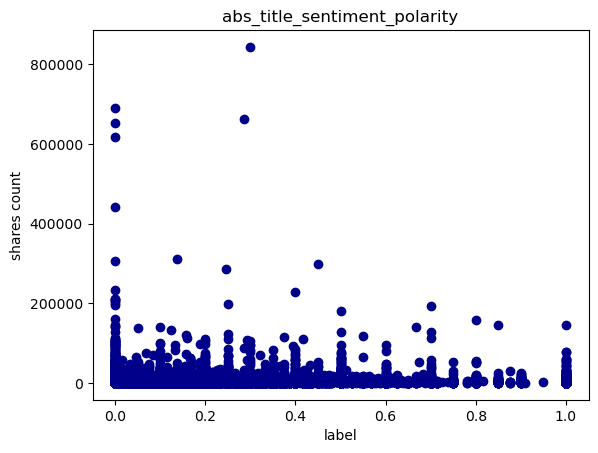

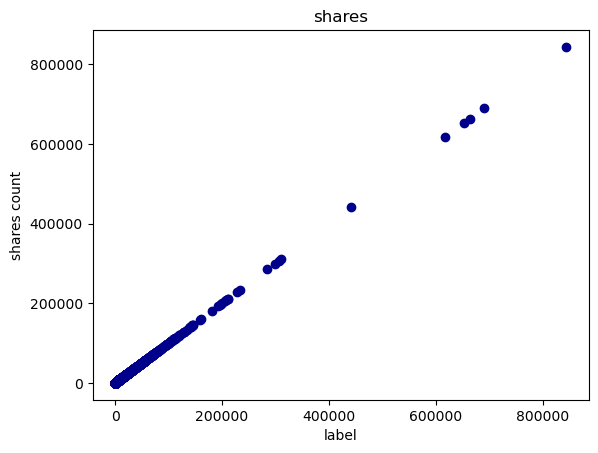

In [72]:
# Iterate over each feature column and plot against "shares".
for label in df1.columns[:]:
    plt.scatter(df1[label],df1["shares"], color="darkblue")
    plt.title(label)
    plt.ylabel("shares count")
    plt.xlabel("label")
    plt.show()

# Identifying Outliers: Boxplots for Each Feature Column


In [73]:
# here why im using subplot ,'organize multiple visualizations within a single figure'

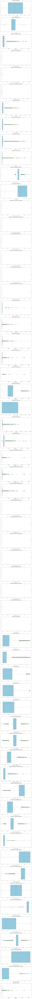

In [74]:
# Select numeric columns for boxplots
numeric_cols = df1.select_dtypes(include=['float64', 'int64']).columns

plt.figure(figsize=(10, len(numeric_cols) * 5))

# Create a grid of boxplots for each numeric column using a 'for' loop
for i, col in enumerate(numeric_cols, 1):
    plt.subplot(len(numeric_cols), 1, i)
    sns.boxplot(x=df1[col], color='skyblue', flierprops=dict(marker='*', markersize=10, markerfacecolor='green', linestyle='none'))
    plt.title(f'Boxplot of {col}', fontsize=15)  # Giving title 

plt.tight_layout()
plt.show()

# Outlier Treatment: Handling and Adjusting Outliers in the Dataset

In [75]:
# The IQR is the range between the first quartile (25th percentile) and the third quartile (75th percentile) of the data.

In [76]:
# Technique for detecting and treating outliers using the Interquartile Range (IQR) method.

for column in df1.columns:
    q1 = df1[column].quantile(0.25)    # First Quartile
    q3 = df1[column].quantile(0.75)    # Third Quartile
    IQR = q3 - q1                     # Interquartile Range
    
    llimit = q1 - 1.5 * IQR           # Lower Limit
    ulimit = q3 + 1.5 * IQR           # Upper Limit
    
    # treating outlier with capping tecnique 
    # Clip values in the column to llimit and ulimit
    df1[column] = df1[column].clip(llimit, ulimit) # instead of fillna using clip function

# Post-Treatment Outlier Analysis: Boxplots for Updated Feature Distributions

In [77]:
# Set up the matplotlib figure
plt.figure(figsize=(40, 300))

# Create a grid of boxplots for each numeric column using a 'for' loop
numeric_cols = df1.select_dtypes(include=['float64', 'int64']).columns
for i, col in enumerate(numeric_cols, 1):
    plt.subplot(len(numeric_cols), 1, i)
    sns.boxplot(x=df1[col], color='skyblue', flierprops=dict(marker='*', markersize=20, markerfacecolor='green', linestyle='none'))
    plt.title(f'Boxplot of {col}', fontsize=25)  # Add title to each subplot

plt.tight_layout()
plt.show()

In [78]:
# Note: For outliers, statistically it is good to treat extreme outliers (+3 * IQR and -3 * IQR). Minor outliers are OK.

# After handling the extreme outliers by capping values beyond the ±3 * IQR limits, the data distribution has improved. 
# Boxplots show that the extreme outliers are effectively managed, resulting in a cleaner and more reliable dataset. 
# This makes the data better for future analysis and modeling.

# Feature Scaling: Normalizing and Standardizing Data for Improved Model Performance

# Feature Standardization: Transforming Data to Zero Mean and Unit Variance

In [79]:
# standardization StandardScaler
df_stand=df1.copy()
from sklearn.preprocessing import StandardScaler
# standardScaler - class , 
ss=StandardScaler()
scaled_values=ss.fit_transform(df_stand)

In [80]:
# Creating a new table with data that has been standardized.
new_df=pd.DataFrame(scaled_values, columns=df1.columns)

In [81]:
new_df

,timedelta,n_tokens_title,n_tokens_content,n_unique_tokens,n_non_stop_words,n_non_stop_unique_tokens,num_hrefs,num_self_hrefs,num_imgs,num_videos,average_token_length,num_keywords,data_channel_is_lifestyle,data_channel_is_entertainment,data_channel_is_bus,data_channel_is_socmed,data_channel_is_tech,data_channel_is_world,kw_min_min,kw_max_min,kw_avg_min,kw_min_max,kw_max_max,kw_avg_max,kw_min_avg,kw_max_avg,kw_avg_avg,self_reference_min_shares,self_reference_max_shares,self_reference_avg_sharess,weekday_is_monday,weekday_is_tuesday,weekday_is_wednesday,weekday_is_thursday,weekday_is_friday,weekday_is_saturday,weekday_is_sunday,is_weekend,LDA_00,LDA_01,LDA_02,LDA_03,LDA_04,global_subjectivity,global_sentiment_polarity,global_rate_positive_words,global_rate_negative_words,rate_positive_words,rate_negative_words,avg_positive_polarity,min_positive_polarity,max_positive_polarity,avg_negative_polarity,min_negative_polarity,max_negative_polarity,title_subjectivity,title_sentiment_polarity,abs_title_subjectivity,abs_title_sentiment_polarity,shares
0,1.757880,0.762298,-0.818964,1.136057,-0.775853,1.219185,-0.771588,-0.410225,-0.551232,-0.670398,0.059840,-1.166388,0.0,0.0,0.0,0.0,0.0,0.0,-0.478839,-1.583910,-1.567781,-0.728883,0.0,-1.984874,-0.982156,-2.574609,-2.571007,-0.755805,-0.820141,-0.843413,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.704218,2.019285,-0.634617,-0.618696,-0.670541,0.775010,-0.287624,0.365028,-0.266477,0.481843,-0.367125,0.242640,0.276470,-0.228941,-0.776126,-0.268895,-1.706160,0.671245,-1.502111,-1.810719,0.211011,-0.941884
1,1.757880,-0.664029,-0.720677,0.602478,-0.491458,0.997517,-0.899923,-0.840666,-0.551232,-0.670398,0.839417,-1.690746,0.0,0.0,0.0,0.0,0.0,0.0,-0.478839,-1.583910,-1.567781,-0.728883,0.0,-1.984874,-0.982156,-2.574609,-2.571007,-1.030547,-0.902719,-0.978170,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.024521,-0.422844,-0.596968,-0.588687,-0.636381,-1.171057,0.322831,0.216031,-0.060137,0.257617,-0.131835,-0.807729,-1.198807,-0.228941,1.154903,1.367424,-0.033906,-0.870807,-0.379416,0.837749,-0.743422,-0.869086
2,1.757880,-0.664029,-0.840806,0.333985,-0.981974,-0.213806,-0.899923,-0.840666,-0.551232,-0.670398,-0.898932,-0.642030,0.0,0.0,0.0,0.0,0.0,0.0,-0.478839,-1.583910,-1.567781,-0.728883,0.0,-1.984874,-0.982156,-2.574609,-2.571007,-0.522053,-0.749883,-0.728760,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.300890,-0.563816,-0.659439,-0.645618,1.549759,2.446974,2.210799,1.026551,-0.704558,1.030969,-0.943346,1.584743,0.276470,0.981798,-1.750339,-0.957871,-0.591324,-0.870807,-0.379416,0.837749,-0.743422,-0.382329
3,1.757880,-0.664029,0.032856,-0.312838,0.556540,-0.197074,-0.129912,-1.271108,-0.551232,-0.670398,-0.860409,-0.117671,0.0,0.0,0.0,0.0,0.0,0.0,-0.478839,-1.583910,-1.567781,-0.728883,0.0,-1.984874,-0.982156,-2.574609,-2.571007,-1.030547,-0.902719,-0.978170,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.638933,2.019285,1.061553,-0.660655,-0.710484,-0.215089,-0.199469,0.115356,0.461969,-0.158804,0.305133,0.326567,1.081166,0.174639,-0.940603,-0.268895,-1.148742,-0.870807,-0.379416,0.837749,-0.743422,-0.567408
4,1.757880,1.237741,1.509891,-1.111984,1.038069,-1.376851,1.153441,2.387646,1.822156,-0.670398,0.068093,-0.117671,0.0,0.0,0.0,0.0,0.0,0.0,-0.478839,-1.583910,-1.567781,-0.728883,0.0,-1.984874,-0.982156,-2.574609,-2.571007,-0.728663,1.761104,-0.122039,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.638637,-0.602120,-0.677258,-0.661786,2.252569,0.687455,1.752519,2.074303,-0.429645,1.050159,-0.963483,0.614718,-1.198807,0.981798,0.307820,0.075594,0.802221,0.531059,0.437090,-1.569949,-0.049289,-0.996174
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39639,-1.618083,0.286856,-0.472229,-0.083779,-0.121542,-0.015983,-0.129912,1.741984,-0.551232,0.581711,-0.465459,0.406687,0.0,0.0,0.0,0.0,0.0,0.0,-0.720854,-0.230842,-0.550234,2.067921,0.0,0.906277,1.228718,-0.5

In [82]:
# Checking if the data in the table has been standardized.
new_df['n_tokens_title'].mean()

-8.029541560400689e-17

#  Visualizing Data After Standardization

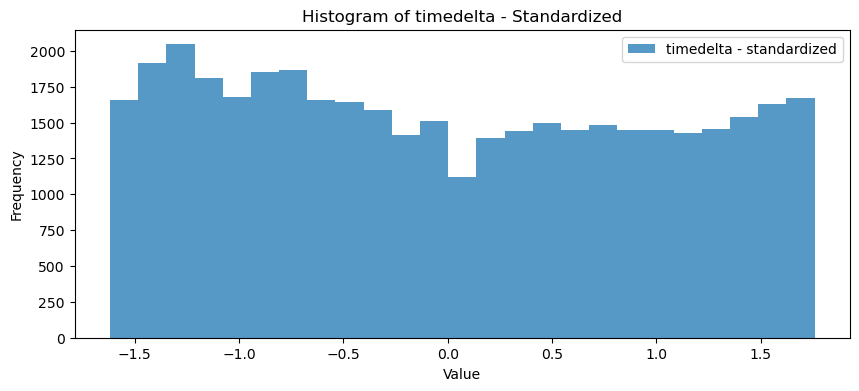

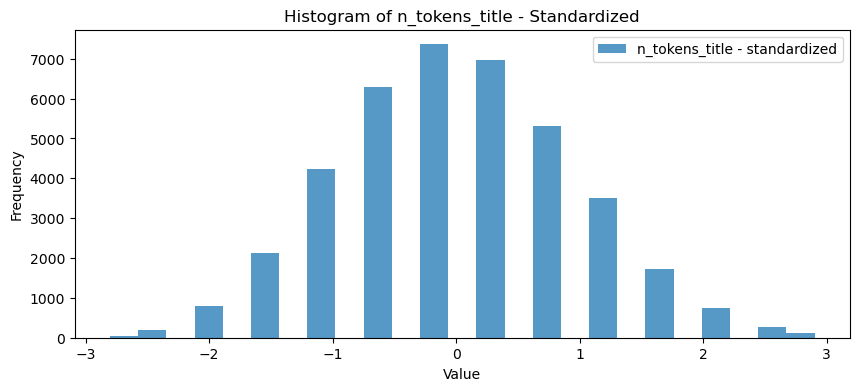

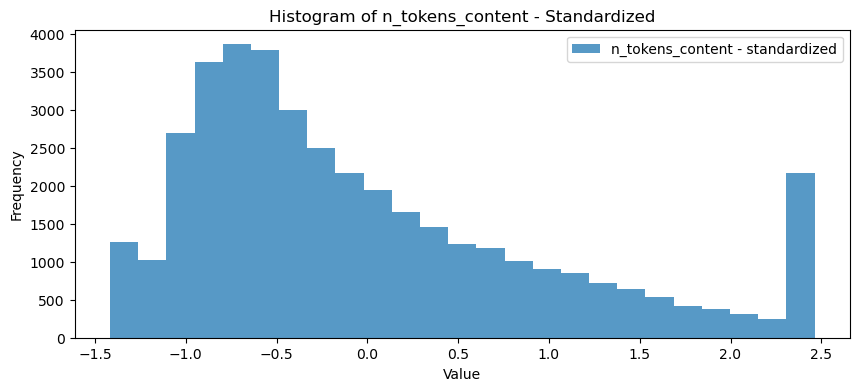

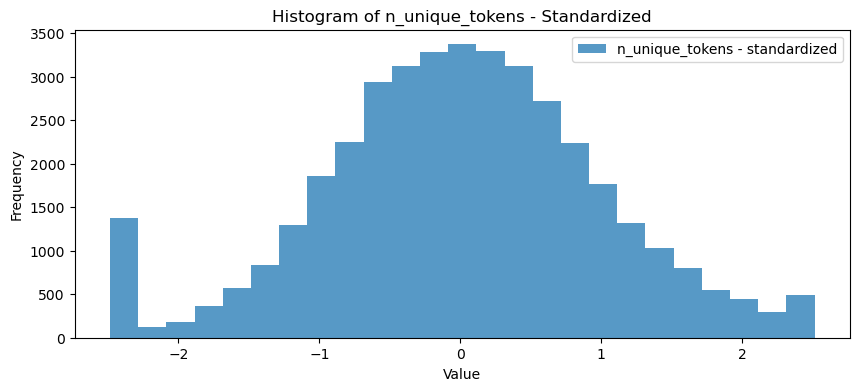

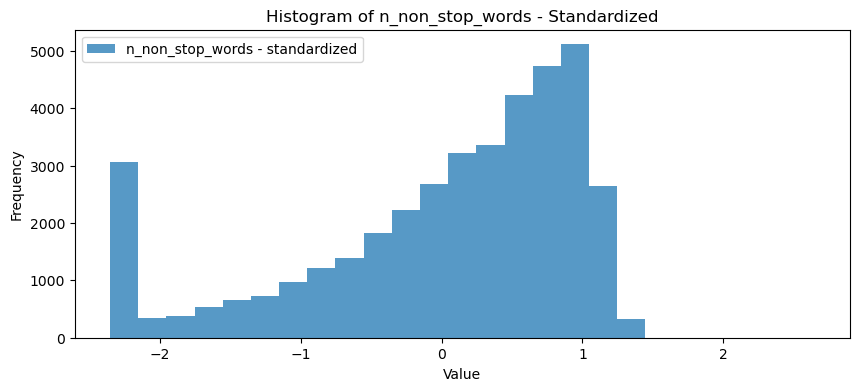

...

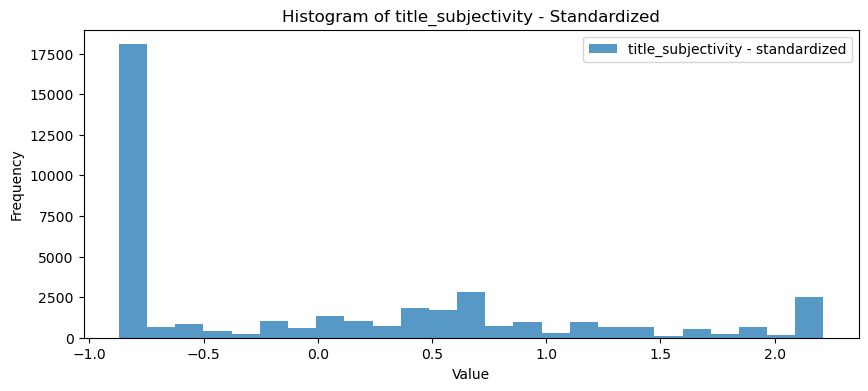

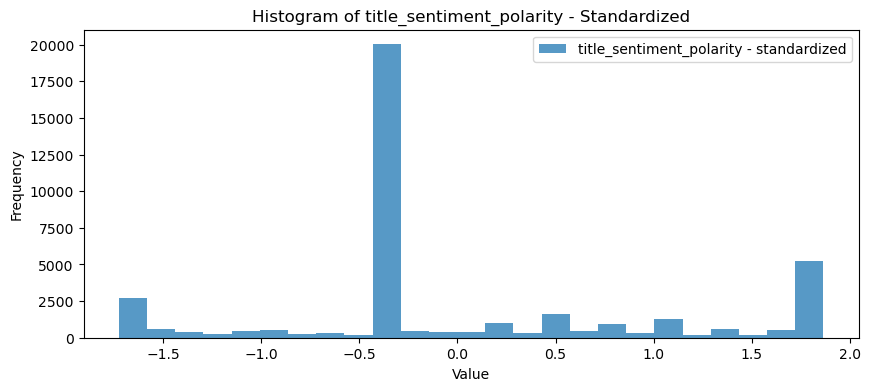

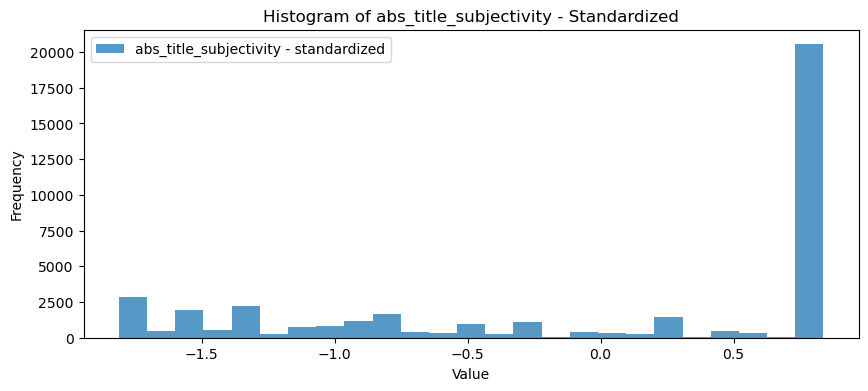

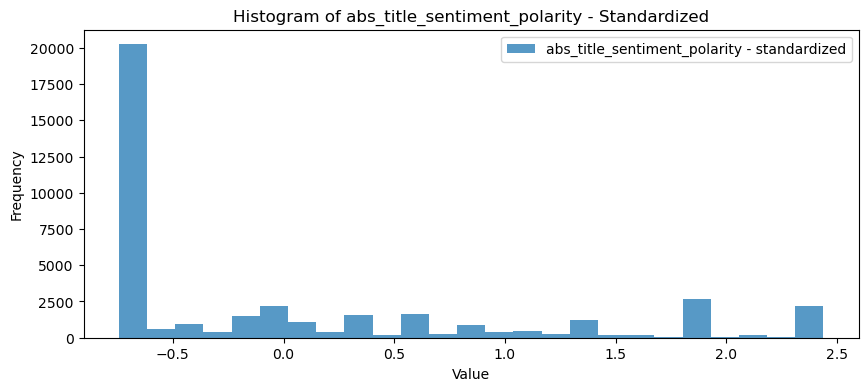

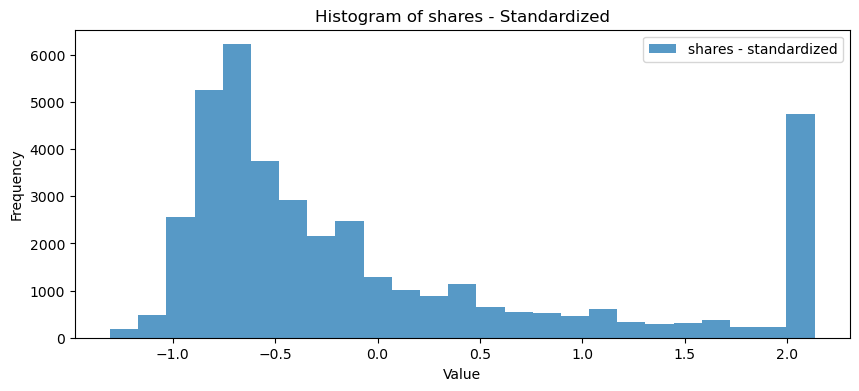

In [83]:
# Histograms of Standardized Features
for column in new_df.columns:
    plt.figure(figsize=(10, 4))  
    plt.hist(new_df[column], bins=25, alpha=0.75, label=f'{column} - standardized')
    plt.title(f'Histogram of {column} - Standardized')
    plt.xlabel('Value')
    plt.ylabel('Frequency')
    plt.legend()
    plt.show()

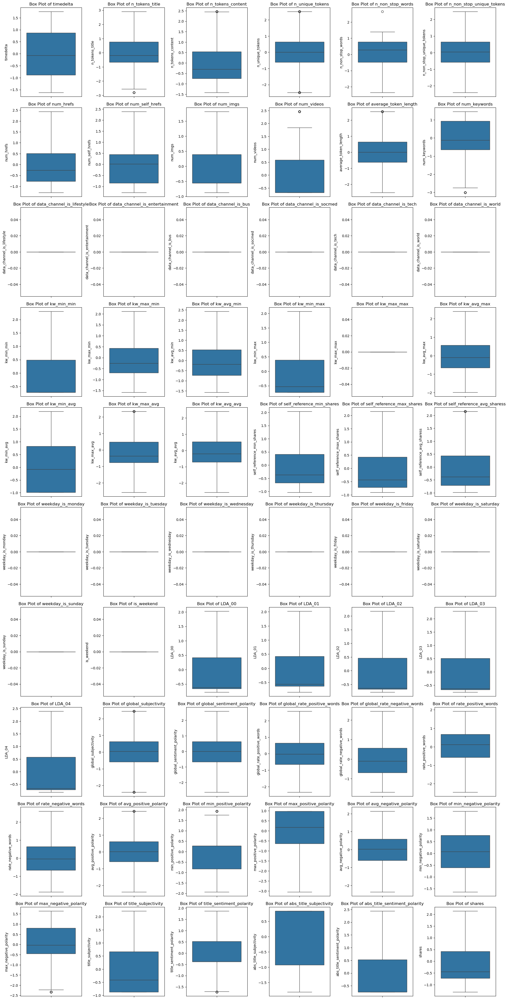

In [84]:
# Boxplots of Standardized Features
plt.figure(figsize=(20, 40))  

# Increase subplot size or reduce the number of plots per row/column
for i, column in enumerate(new_df.columns):
    plt.subplot(10, 6, i + 1)  # Adjust the grid size according to the number of variables
    sns.boxplot(y=new_df[column])
    plt.title(f'Box Plot of {column}')

plt.tight_layout()  # Adjust layout
plt.show()


# Density Plot Visualization of standardized Data

In [85]:
# DENSITY PLOT

# Filtering out columns with 0 variance
non_zero_var_columns = new_df.loc[:, new_df.var() != 0]

# Plotting density plots of standardized variables
num_columns = len(non_zero_var_columns.columns)
num_rows = (num_columns // 4) + (1 if num_columns % 4 != 0 else 0)

fig, axes = plt.subplots(num_rows, 4, figsize=(80, 70))
axes = axes.flatten()

for i, col in enumerate(non_zero_var_columns.columns):
    sns.kdeplot(non_zero_var_columns[col], ax=axes[i], fill=True, color='blue')
    axes[i].set_title(f'Density Plot of {col}', fontsize=35, color='darkblue')

for i in range(len(non_zero_var_columns.columns), len(axes)):
    fig.delaxes(axes[i])

plt.suptitle('Density Plots of Standardized Variables', fontsize=80, color='green')
plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()


In [86]:
# This process standardizes the data, ensuring that each feature has a mean of 0 and a standard deviation of 1.

# Feature Normalization: Scaling Data to a Range of [0, 1]

In [87]:
# Normalization - MinMaxScaler
df_norm=df1.copy()
from sklearn.preprocessing import MinMaxScaler
# MinMaxScaler - class , 
mm=MinMaxScaler()
scaled_values_norm=mm.fit_transform(df_norm)

In [88]:
# Creating a new table with data that has been normalized
new_df1=pd.DataFrame(scaled_values_norm, columns=df1.columns)

In [89]:
new_df1

,timedelta,n_tokens_title,n_tokens_content,n_unique_tokens,n_non_stop_words,n_non_stop_unique_tokens,num_hrefs,num_self_hrefs,num_imgs,num_videos,average_token_length,num_keywords,data_channel_is_lifestyle,data_channel_is_entertainment,data_channel_is_bus,data_channel_is_socmed,data_channel_is_tech,data_channel_is_world,kw_min_min,kw_max_min,kw_avg_min,kw_min_max,kw_max_max,kw_avg_max,kw_min_avg,kw_max_avg,kw_avg_avg,self_reference_min_shares,self_reference_max_shares,self_reference_avg_sharess,weekday_is_monday,weekday_is_tuesday,weekday_is_wednesday,weekday_is_thursday,weekday_is_friday,weekday_is_saturday,weekday_is_sunday,is_weekend,LDA_00,LDA_01,LDA_02,LDA_03,LDA_04,global_subjectivity,global_sentiment_polarity,global_rate_positive_words,global_rate_negative_words,rate_positive_words,rate_negative_words,avg_positive_polarity,min_positive_polarity,max_positive_polarity,avg_negative_polarity,min_negative_polarity,max_negative_polarity,title_subjectivity,title_sentiment_polarity,abs_title_subjectivity,abs_title_sentiment_polarity,shares
0,1.0,0.625000,0.154117,0.724580,0.315600,0.742842,0.137931,0.235294,0.117647,0.0,0.509128,0.411765,0.0,0.0,0.0,0.0,0.0,0.0,0.08,0.000000,0.001469,0.000000,0.0,0.000000,0.000277,0.000000,0.000000,0.089506,0.027030,0.043025,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.885825,1.000000,0.050467,0.046024,0.043273,0.654607,0.447464,0.549339,0.343111,0.670330,0.337500,0.547062,0.571429,0.70,0.352570,0.400,0.157895,0.500000,0.062500,0.000000,0.300000,0.106093
1,1.0,0.375000,0.179451,0.617830,0.372450,0.697381,0.103448,0.117647,0.117647,0.0,0.664108,0.294118,0.0,0.0,0.0,0.0,0.0,0.0,0.08,0.000000,0.001469,0.000000,0.0,0.000000,0.000277,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.000000,0.147387,0.063198,0.055882,0.053927,0.252591,0.564862,0.518964,0.392896,0.619048,0.390000,0.329059,0.190476,0.70,0.780336,0.875,0.578947,0.000000,0.375000,1.000000,0.000000,0.127240
2,1.0,0.375000,0.148487,0.564115,0.274397,0.448951,0.103448,0.117647,0.117647,0.0,0.318523,0.529412,0.0,0.0,0.0,0.0,0.0,0.0,0.08,0.000000,0.001469,0.000000,0.0,0.000000,0.000277,0.000000,0.000000,0.165659,0.050027,0.079631,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.385596,0.098170,0.042074,0.037180,0.735758,1.000000,0.927938,0.684200,0.237413,0.795918,0.208929,0.825613,0.571429,1.00,0.136761,0.200,0.438596,0.000000,0.375000,1.000000,0.000000,0.268638
3,1.0,0.375000,0.373681,0.434709,0.581943,0.452382,0.310345,0.000000,0.117647,0.0,0.326182,0.647059,0.0,0.0,0.0,0.0,0.0,0.0,0.08,0.000000,0.001469,0.000000,0.0,0.000000,0.000277,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.050588,1.000000,0.624017,0.032240,0.030815,0.450074,0.464418,0.498440,0.518867,0.523810,0.487500,0.564481,0.779221,0.80,0.316135,0.400,0.298246,0.000000,0.375000,1.000000,0.000000,0.214875
4,1.0,0.708333,0.754398,0.274828,0.678199,0.210422,0.655172,1.000000,1.000000,0.0,0.510768,0.647059,0.0,0.0,0.0,0.0,0.0,0.0,0.08,0.000000,0.001469,0.000000,0.0,0.000000,0.000277,0.000000,0.000000,0.098349,0.871935,0.273343,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.050694,0.084797,0.036048,0.031868,0.954956,0.636520,0.839806,0.897800,0.303743,0.800307,0.204435,0.624286,0.190476,1.00,0.592689,0.500,0.789474,0.454545,0.602273,0.090909,0.218182,0.090323
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39639,0.0,0.541667,0.243490,0.480535,0.446395,0.489522,0.310345,0.823529,0.117647,0.4,0.404698,0.764706,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.366166,0.255737,1.000000,0.0,0.659936,0.696103,0.412533,0.508166,1.000000,1.000000,1.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.044329,0.073627,0.191376,0.027885,0.833982,0.567820,0.550322,0.452014,0.361953,0.603175,0.406250,0.440475,0.571429,0.75,0.519052,0.500,0.473684,0.100000,0.375000,0.800000,0.000000,0.322401
39640,0.0,0.625000,0.

In [90]:
# Checking if the data in the table has been normalized.
new_df1.describe()

,timedelta,n_tokens_title,n_tokens_content,n_unique_tokens,n_non_stop_words,n_non_stop_unique_tokens,num_hrefs,num_self_hrefs,num_imgs,num_videos,average_token_length,num_keywords,data_channel_is_lifestyle,data_channel_is_entertainment,data_channel_is_bus,data_channel_is_socmed,data_channel_is_tech,data_channel_is_world,kw_min_min,kw_max_min,kw_avg_min,kw_min_max,kw_max_max,kw_avg_max,kw_min_avg,kw_max_avg,kw_avg_avg,self_reference_min_shares,self_reference_max_shares,self_reference_avg_sharess,weekday_is_monday,weekday_is_tuesday,weekday_is_wednesday,weekday_is_thursday,weekday_is_friday,weekday_is_saturday,weekday_is_sunday,is_weekend,LDA_00,LDA_01,LDA_02,LDA_03,LDA_04,global_subjectivity,global_sentiment_polarity,global_rate_positive_words,global_rate_negative_words,rate_positive_words,rate_negative_words,avg_positive_polarity,min_positive_polarity,max_positive_polarity,avg_negative_polarity,min_negative_polarity,max_negative_polarity,title_subjectivity,title_sentiment_polarity,abs_title_subjectivity,abs_title_sentiment_polarity,shares
count,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.0,39644.0,39644.0,39644.0,39644.0,39644.0,39644.000000,39644.000000,39644.000000,39644.000000,39644.0,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.0,39644.0,39644.0,39644.0,39644.0,39644.0,39644.0,39644.0,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000
mean,0.479295,0.491388,0.365211,0.497296,0.470691,0.492800,0.345251,0.347416,0.322578,0.214166,0.497232,0.673460,0.0,0.0,0.0,0.0,0.0,0.0,0.238284,0.428637,0.393231,0.260613,0.0,0.453069,0.309390,0.523501,0.516870,0.335735,0.295482,0.312307,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.278342,0.295013,0.265059,0.249268,0.252407,0.494507,0.502778,0.474923,0.407405,0.560129,0.419416,0.496702,0.500037,0.756728,0.524500,0.478056,0.587484,0.282353,0.480610,0.683686,0.233674,0.379701
std,0.296215,0.175278,0.257761,0.200067,0.199900,0.205092,0.268696,0.273321,0.371774,0.319465,0.198803,0.224367,0.0,0.0,0.0,0.0,0.0,0.0,0.330562,0.270623,0.249887,0.357555,0.0,0.228264,0.314733,0.203335,0.201040,0.325788,0.327329,0.319281,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.356463,0.349131,0.338149,0.328509,0.311892,0.206582,0.192313,0.203867,0.241278,0.228709,0.223131,0.207551,0.258228,0.247786,0.221525,0.290290,0.251791,0.324247,0.278352,0.377582,0.314327,0.290493
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.215768,0.375000,0.173118,0.375000,0.375000,0.375000,0.137931,0.117647,0.117647,0.000000,0.375000,0.529412,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.242838,0.209657,0.000000,0.0,0.304212,0.000277,0.366972,0.375000,0.115312,0.059946,0.085112,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.044351,0.073661,0.036044,0.031868,0.030817,0.375000,0.375000,0.341478,0.240838,0.428571,0.270833,0.375000,0.285714,0.600000,0.392558,0.300000,0.473684,0.000000,0.375000,0.333333,0.000000,0.169355
50%,0.457815,0.458333,0.287825,0.498989,0.527701,0.500566,0.275862,0.352941,0.117647,0.000000,0.498314,0.647059,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.360164,0.347347,0.070886,0.0,0.430449,0.283515,0.448729,0.475106,0.216548,0.152589,0.190836,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.059112,0.098201,0.050466,0.044616,0.043926,0.502691,0.502752,0.469464,0.384158,0.586

# Density Plot Visualization of Normalized Data

In [91]:

# Filtering out columns with 0 variance
non_zero_var_columns = new_df1.loc[:, new_df1.var() != 0]

# Plotting density plots of normalized variables
num_columns = len(non_zero_var_columns.columns)
num_rows = (num_columns // 4) + (1 if num_columns % 4 != 0 else 0)

fig, axes = plt.subplots(num_rows, 4, figsize=(80, 70))
axes = axes.flatten()

for i, col in enumerate(non_zero_var_columns.columns):
    sns.kdeplot(non_zero_var_columns[col], ax=axes[i], fill=True, color='blue')
    axes[i].set_title(f'Density Plot of {col}', fontsize=35, color='darkblue')

for i in range(len(non_zero_var_columns.columns), len(axes)):
    fig.delaxes(axes[i])

plt.suptitle('Density Plots of Normalized Variables', size=80 , color='green')
plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()

# Box Plots of Normalized Feature

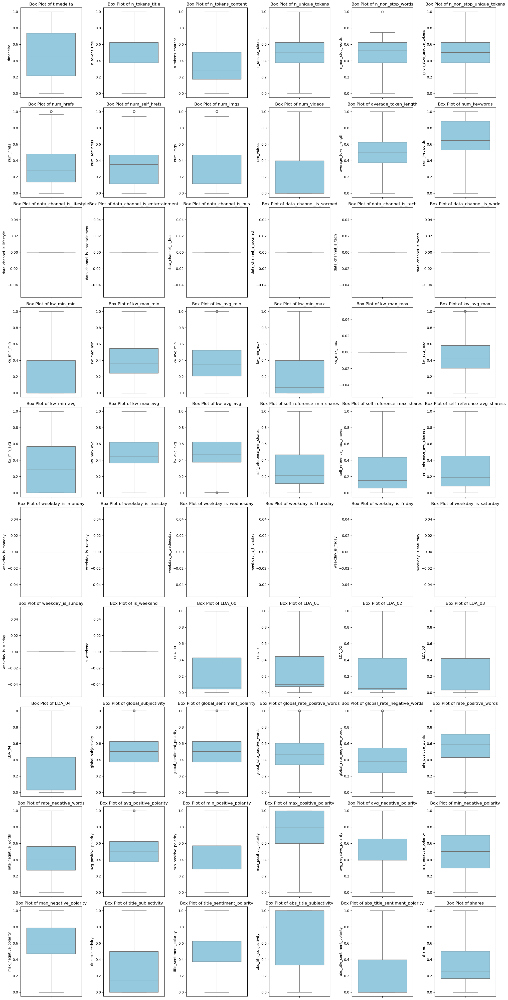

In [92]:
 
# Plotting box plots of normalized variables
plt.figure(figsize=(20, 40))  # Adjust figure size for better visualization

# Increase subplot size or reduce the number of plots per row/column
for i, column in enumerate(new_df1.columns):
    plt.subplot(10, 6, i + 1)  # Adjust the grid size according to the number of variables
    sns.boxplot(y=new_df1[column], color='skyblue')  # Use a consistent blue color
    plt.title(f'Box Plot of {column}', fontsize=12)  # Set title font size

plt.tight_layout()  # Adjust layout to prevent overlap
plt.show()

In [93]:
# Normalization scales data to a 0-1 range so that each feature is treated equally, which helps algorithms perform better and produce more accurate results.

# I applied feature scaling methods, specifically standardization and normalization, to the dataset. This process produced a new dataset.

# Feature Selection

In [95]:
# using Regreesive Feature Elimination Technique 

In [96]:
new_df.head()

,timedelta,n_tokens_title,n_tokens_content,n_unique_tokens,n_non_stop_words,n_non_stop_unique_tokens,num_hrefs,num_self_hrefs,num_imgs,num_videos,average_token_length,num_keywords,data_channel_is_lifestyle,data_channel_is_entertainment,data_channel_is_bus,data_channel_is_socmed,data_channel_is_tech,data_channel_is_world,kw_min_min,kw_max_min,kw_avg_min,kw_min_max,kw_max_max,kw_avg_max,kw_min_avg,kw_max_avg,kw_avg_avg,self_reference_min_shares,self_reference_max_shares,self_reference_avg_sharess,weekday_is_monday,weekday_is_tuesday,weekday_is_wednesday,weekday_is_thursday,weekday_is_friday,weekday_is_saturday,weekday_is_sunday,is_weekend,LDA_00,LDA_01,LDA_02,LDA_03,LDA_04,global_subjectivity,global_sentiment_polarity,global_rate_positive_words,global_rate_negative_words,rate_positive_words,rate_negative_words,avg_positive_polarity,min_positive_polarity,max_positive_polarity,avg_negative_polarity,min_negative_polarity,max_negative_polarity,title_subjectivity,title_sentiment_polarity,abs_title_subjectivity,abs_title_sentiment_polarity,shares
0,1.75788,0.762298,-0.818964,1.136057,-0.775853,1.219185,-0.771588,-0.410225,-0.551232,-0.670398,0.059840,-1.166388,0.0,0.0,0.0,0.0,0.0,0.0,-0.478839,-1.58391,-1.567781,-0.728883,0.0,-1.984874,-0.982156,-2.574609,-2.571007,-0.755805,-0.820141,-0.843413,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.704218,2.019285,-0.634617,-0.618696,-0.670541,0.775010,-0.287624,0.365028,-0.266477,0.481843,-0.367125,0.242640,0.276470,-0.228941,-0.776126,-0.268895,-1.706160,0.671245,-1.502111,-1.810719,0.211011,-0.941884
1,1.75788,-0.664029,-0.720677,0.602478,-0.491458,0.997517,-0.899923,-0.840666,-0.551232,-0.670398,0.839417,-1.690746,0.0,0.0,0.0,0.0,0.0,0.0,-0.478839,-1.58391,-1.567781,-0.728883,0.0,-1.984874,-0.982156,-2.574609,-2.571007,-1.030547,-0.902719,-0.978170,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.024521,-0.422844,-0.596968,-0.588687,-0.636381,-1.171057,0.322831,0.216031,-0.060137,0.257617,-0.131835,-0.807729,-1.198807,-0.228941,1.154903,1.367424,-0.033906,-0.870807,-0.379416,0.837749,-0.743422,-0.869086
2,1.75788,-0.664029,-0.840806,0.333985,-0.981974,-0.213806,-0.899923,-0.840666,-0.551232,-0.670398,-0.898932,-0.642030,0.0,0.0,0.0,0.0,0.0,0.0,-0.478839,-1.58391,-1.567781,-0.728883,0.0,-1.984874,-0.982156,-2.574609,-2.571007,-0.522053,-0.749883,-0.728760,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.300890,-0.563816,-0.659439,-0.645618,1.549759,2.446974,2.210799,1.026551,-0.704558,1.030969,-0.943346,1.584743,0.276470,0.981798,-1.750339,-0.957871,-0.591324,-0.870807,-0.379416,0.837749,-0.743422,-0.382329
3,1.75788,-0.664029,0.032856,-0.312838,0.556540,-0.197074,-0.129912,-1.271108,-0.551232,-0.670398,-0.860409,-0.117671,0.0,0.0,0.0,0.0,0.0,0.0,-0.478839,-1.58391,-1.567781,-0.728883,0.0,-1.984874,-0.982156,-2.574609,-2.571007,-1.030547,-0.902719,-0.978170,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.638933,2.019285,1.061553,-0.660655,-0.710484,-0.215089,-0.199469,0.115356,0.461969,-0.158804,0.305133,0.326567,1.081166,0.174639,-0.940603,-0.268895,-1.148742,-0.870807,-0.379416,0.837749,-0.743422,-0.567408
4,1.75788,1.237741,1.509891,-1.111984,1.038069,-1.376851,1.153441,2.387646,1.822156,-0.670398,0.068093,-0.117671,0.0,0.0,0.0,0.0,0.0,0.0,-0.478839,-1.58391,-1.567781,-0.728883,0.0,-1.984874,-0.982156,-2.574609,-2.571007,-0.728663,1.761104,-0.122039,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.638637,-0.602120,-0.677258,-0.661786,2.252569,0.687455,1.752519,2.074303,-0.429645,1.050159,-0.963483,0.614718,-1.198807,0.981798,0.307820,0.075594,0.802221,0.531059,0.437090,-1.569949,-0.049289,-0.996174


# Splitting Data into Features and Target Variable

In [97]:
# Assuming new_df is already defined
X = new_df.drop(columns='shares', axis=1)
y = new_df['shares']

In [98]:
X.head()

,timedelta,n_tokens_title,n_tokens_content,n_unique_tokens,n_non_stop_words,n_non_stop_unique_tokens,num_hrefs,num_self_hrefs,num_imgs,num_videos,average_token_length,num_keywords,data_channel_is_lifestyle,data_channel_is_entertainment,data_channel_is_bus,data_channel_is_socmed,data_channel_is_tech,data_channel_is_world,kw_min_min,kw_max_min,kw_avg_min,kw_min_max,kw_max_max,kw_avg_max,kw_min_avg,kw_max_avg,kw_avg_avg,self_reference_min_shares,self_reference_max_shares,self_reference_avg_sharess,weekday_is_monday,weekday_is_tuesday,weekday_is_wednesday,weekday_is_thursday,weekday_is_friday,weekday_is_saturday,weekday_is_sunday,is_weekend,LDA_00,LDA_01,LDA_02,LDA_03,LDA_04,global_subjectivity,global_sentiment_polarity,global_rate_positive_words,global_rate_negative_words,rate_positive_words,rate_negative_words,avg_positive_polarity,min_positive_polarity,max_positive_polarity,avg_negative_polarity,min_negative_polarity,max_negative_polarity,title_subjectivity,title_sentiment_polarity,abs_title_subjectivity,abs_title_sentiment_polarity
0,1.75788,0.762298,-0.818964,1.136057,-0.775853,1.219185,-0.771588,-0.410225,-0.551232,-0.670398,0.059840,-1.166388,0.0,0.0,0.0,0.0,0.0,0.0,-0.478839,-1.58391,-1.567781,-0.728883,0.0,-1.984874,-0.982156,-2.574609,-2.571007,-0.755805,-0.820141,-0.843413,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.704218,2.019285,-0.634617,-0.618696,-0.670541,0.775010,-0.287624,0.365028,-0.266477,0.481843,-0.367125,0.242640,0.276470,-0.228941,-0.776126,-0.268895,-1.706160,0.671245,-1.502111,-1.810719,0.211011
1,1.75788,-0.664029,-0.720677,0.602478,-0.491458,0.997517,-0.899923,-0.840666,-0.551232,-0.670398,0.839417,-1.690746,0.0,0.0,0.0,0.0,0.0,0.0,-0.478839,-1.58391,-1.567781,-0.728883,0.0,-1.984874,-0.982156,-2.574609,-2.571007,-1.030547,-0.902719,-0.978170,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.024521,-0.422844,-0.596968,-0.588687,-0.636381,-1.171057,0.322831,0.216031,-0.060137,0.257617,-0.131835,-0.807729,-1.198807,-0.228941,1.154903,1.367424,-0.033906,-0.870807,-0.379416,0.837749,-0.743422
2,1.75788,-0.664029,-0.840806,0.333985,-0.981974,-0.213806,-0.899923,-0.840666,-0.551232,-0.670398,-0.898932,-0.642030,0.0,0.0,0.0,0.0,0.0,0.0,-0.478839,-1.58391,-1.567781,-0.728883,0.0,-1.984874,-0.982156,-2.574609,-2.571007,-0.522053,-0.749883,-0.728760,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.300890,-0.563816,-0.659439,-0.645618,1.549759,2.446974,2.210799,1.026551,-0.704558,1.030969,-0.943346,1.584743,0.276470,0.981798,-1.750339,-0.957871,-0.591324,-0.870807,-0.379416,0.837749,-0.743422
3,1.75788,-0.664029,0.032856,-0.312838,0.556540,-0.197074,-0.129912,-1.271108,-0.551232,-0.670398,-0.860409,-0.117671,0.0,0.0,0.0,0.0,0.0,0.0,-0.478839,-1.58391,-1.567781,-0.728883,0.0,-1.984874,-0.982156,-2.574609,-2.571007,-1.030547,-0.902719,-0.978170,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.638933,2.019285,1.061553,-0.660655,-0.710484,-0.215089,-0.199469,0.115356,0.461969,-0.158804,0.305133,0.326567,1.081166,0.174639,-0.940603,-0.268895,-1.148742,-0.870807,-0.379416,0.837749,-0.743422
4,1.75788,1.237741,1.509891,-1.111984,1.038069,-1.376851,1.153441,2.387646,1.822156,-0.670398,0.068093,-0.117671,0.0,0.0,0.0,0.0,0.0,0.0,-0.478839,-1.58391,-1.567781,-0.728883,0.0,-1.984874,-0.982156,-2.574609,-2.571007,-0.728663,1.761104,-0.122039,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.638637,-0.602120,-0.677258,-0.661786,2.252569,0.687455,1.752519,2.074303,-0.429645,1.050159,-0.963483,0.614718,-1.198807,0.981798,0.307820,0.075594,0.802221,0.531059,0.437090,-1.569949,-0.049289


In [99]:
y.head()

0   -0.941884
1   -0.869086
2   -0.382329
3   -0.567408
4   -0.996174
Name: shares, dtype: float64

# Feature Selection Using Recursive Feature Elimination (RFE)

In [100]:
from sklearn.feature_selection import RFE
from sklearn.linear_model import LinearRegression

# Initialize the Linear Regression estimator
estimator = LinearRegression()

# Initialize the RFE selector with the estimator
selector = RFE(estimator, n_features_to_select=21, step=1)

# Fit the selector to the data
selector = selector.fit(X, y)

# Display the selected features
selected_features = X.columns[selector.support_]
print("Selected features:", selected_features)

Selected features: Index(['timedelta', 'n_tokens_content', 'n_unique_tokens', 'n_non_stop_words',
       'n_non_stop_unique_tokens', 'num_hrefs', 'num_self_hrefs', 'num_imgs',
       'num_videos', 'kw_avg_max', 'kw_min_avg', 'kw_max_avg', 'kw_avg_avg',
       'self_reference_min_shares', 'self_reference_avg_sharess', 'LDA_00',
       'LDA_01', 'LDA_04', 'global_subjectivity', 'min_positive_polarity',
       'title_sentiment_polarity'],
      dtype='object')


In [101]:
selector.ranking_ # checking best columns

array([ 1, 33,  1,  1,  1,  1,  1,  1,  1,  1, 15, 18, 16, 12, 20, 13, 11,
       31, 37, 10,  8, 34, 28,  1,  1,  1,  1,  1, 17,  1, 24, 23, 30, 19,
       22, 26, 36, 38,  1,  1,  5,  4,  1,  1, 25, 14, 21, 27, 32,  6,  1,
       29,  7,  9, 39,  3,  1,  2, 35])

In [102]:
selected_features=[['timedelta','n_tokens_content', 'n_unique_tokens',
       'n_non_stop_words', 'n_non_stop_unique_tokens', 'num_hrefs',
       'num_self_hrefs', 'num_imgs', 'num_videos', 'kw_avg_max', 'kw_min_avg', 'kw_max_avg',
       'kw_avg_avg', 'self_reference_min_shares','self_reference_avg_sharess','LDA_00','LDA_01', 
        'LDA_04' ,'global_subjectivity', 'min_positive_polarity','title_sentiment_polarity']]


In [103]:
X_new_df=new_df[['timedelta','n_tokens_content', 'n_unique_tokens',
       'n_non_stop_words', 'n_non_stop_unique_tokens', 'num_hrefs',
       'num_self_hrefs', 'num_imgs', 'num_videos', 'kw_avg_max', 'kw_min_avg', 'kw_max_avg',
       'kw_avg_avg', 'self_reference_min_shares','self_reference_avg_sharess','LDA_00','LDA_01', 
        'LDA_04' ,'global_subjectivity', 'min_positive_polarity','title_sentiment_polarity']]

In [104]:
X_new_df.head()

,timedelta,n_tokens_content,n_unique_tokens,n_non_stop_words,n_non_stop_unique_tokens,num_hrefs,num_self_hrefs,num_imgs,num_videos,kw_avg_max,kw_min_avg,kw_max_avg,kw_avg_avg,self_reference_min_shares,self_reference_avg_sharess,LDA_00,LDA_01,LDA_04,global_subjectivity,min_positive_polarity,title_sentiment_polarity
0,1.75788,-0.818964,1.136057,-0.775853,1.219185,-0.771588,-0.410225,-0.551232,-0.670398,-1.984874,-0.982156,-2.574609,-2.571007,-0.755805,-0.843413,1.704218,2.019285,-0.670541,0.775010,0.276470,-1.502111
1,1.75788,-0.720677,0.602478,-0.491458,0.997517,-0.899923,-0.840666,-0.551232,-0.670398,-1.984874,-0.982156,-2.574609,-2.571007,-1.030547,-0.978170,2.024521,-0.422844,-0.636381,-1.171057,-1.198807,-0.379416
2,1.75788,-0.840806,0.333985,-0.981974,-0.213806,-0.899923,-0.840666,-0.551232,-0.670398,-1.984874,-0.982156,-2.574609,-2.571007,-0.522053,-0.728760,0.300890,-0.563816,1.549759,2.446974,0.276470,-0.379416
3,1.75788,0.032856,-0.312838,0.556540,-0.197074,-0.129912,-1.271108,-0.551232,-0.670398,-1.984874,-0.982156,-2.574609,-2.571007,-1.030547,-0.978170,-0.638933,2.019285,-0.710484,-0.215089,1.081166,-0.379416
4,1.75788,1.509891,-1.111984,1.038069,-1.376851,1.153441,2.387646,1.822156,-0.670398,-1.984874,-0.982156,-2.574609,-2.571007,-0.728663,-0.122039,-0.638637,-0.602120,2.252569,0.687455,-1.198807,0.437090


# Correlation 

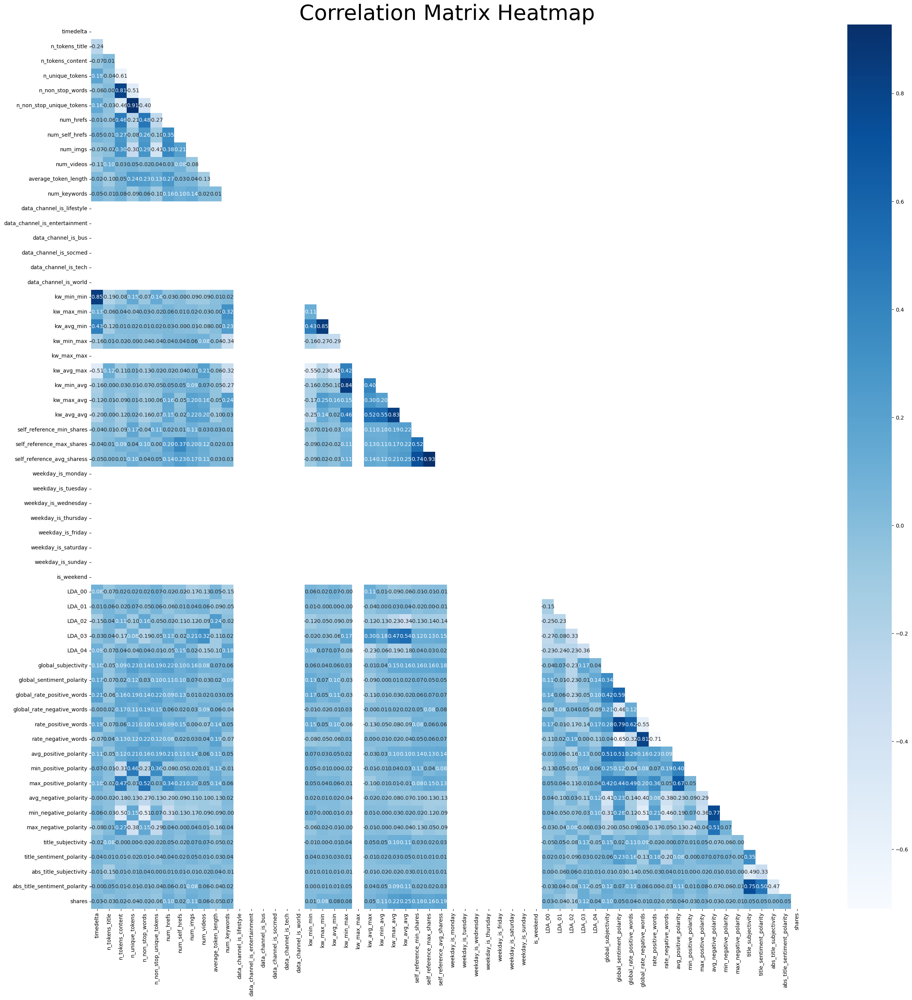

In [161]:
# Calculate the correlation matrix
cor = new_df.corr()

# Plot the correlation heatmap
plt.figure(figsize=(30, 30))

# Mask the upper triangle for a cleaner visualization
mask = np.triu(np.ones_like(cor, dtype=bool))

# Plot the heatmap
sns.heatmap(cor, mask=mask, cmap='Blues', annot=True, fmt='.2f')

plt.title('Correlation Matrix Heatmap' ,fontsize=40)
plt.show()

# Splitting Data into Training and Test Sets (80/20 Split)

In [106]:
# Train and Test
# 80 and 20 (Split the data)
from sklearn.model_selection import train_test_split 
x_train,x_test,y_train,y_test =train_test_split(X_new_df,y,test_size=0.2,random_state=0)  # random_state for reproducibility.

In [107]:
x_train.shape # 80% independent variables

(31715, 21)

In [108]:
y_train.shape # 80% dependent Variables 

(31715,)

In [109]:
x_test.shape # 20% indenpendent variables 

(7929, 21)

In [110]:
y_test.shape # 20 % dependent variables 

(7929,)

In [111]:
# x_train , y_train -- Training 
# x_test -- evaluation(testing)
# y_test -- actual values 

# Applying Linear Regression: Modeling Relationships Between Features and Target Variable

In [112]:
from sklearn.linear_model import LinearRegression
lr=LinearRegression() # calling the LinearRegression
lr.fit(x_train,y_train) # model Training 

LinearRegression()

In [113]:
# to check y=mx+c use coef function best 21 values (M values )
lr.coef_

array([ 0.04700517,  0.02336591, -0.09756344, -0.09117042,  0.02587338,
        0.0594408 , -0.04002546,  0.03674708,  0.04656186, -0.07354221,
       -0.04250901, -0.03234382,  0.29631735,  0.06272912,  0.08746053,
        0.07855104, -0.02356779,  0.08940477,  0.04511803, -0.03476503,
        0.02537799])

In [114]:
# to check intercept use intercept function 
# intercept point tell us it is starting point
# C Values
lr.intercept_

0.0005084146621879072

In [115]:
ycap=lr.predict(x_test)
ycap

array([-0.39726967,  0.18315183, -0.00374148, ...,  0.43080817,
       -0.42060439,  0.12863774])

In [116]:
y_test

18765   -0.740765
16349   -0.320636
27703    2.135358
32947    2.135358
35434    2.135358
           ...   
3537     1.036607
19760    1.098300
21075    2.135358
20480   -0.906102
5914     0.049521
Name: shares, Length: 7929, dtype: float64

In [117]:
# using metrics check the error 

In [118]:
# mean squared error as metrics c1=sigma(y-y^)2/n 
from sklearn import metrics 
mse=metrics.mean_squared_error(y_test,ycap)
rmse=np.sqrt(mse)


In [119]:
mse,rmse

(0.8980936847491647, 0.9476780491016792)

Linear regression model saying on an average (0.9476780491016792) almost 1 unit error

# Mean Squared Error and Root Mean Squared Error of the Model

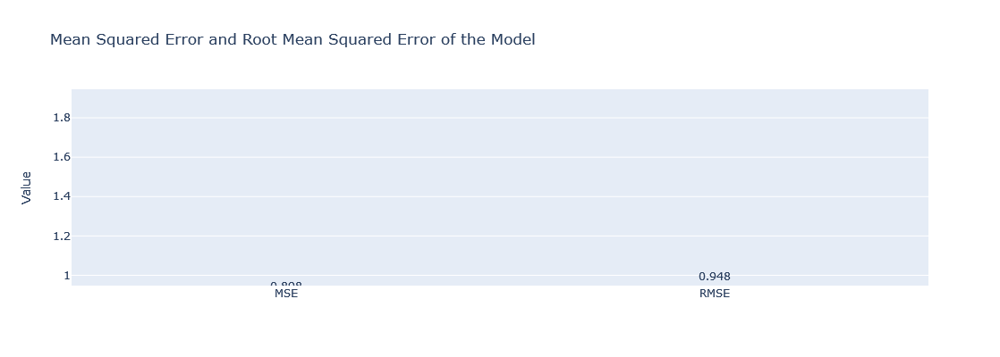

In [120]:
# Define MSE and RMSE values
mse = 0.8980936847491647
rmse = mse**0.5  # Calculating RMSE

# Create the bar chart
fig = px.bar(
    x=['MSE', 'RMSE'],  # Include both MSE and RMSE in x-axis labels
    y=[mse, rmse],      # Corresponding y-axis values
    text=[f'{mse:.3f}', f'{rmse:.3f}'],  # Text annotations for both MSE and RMSE
    title="Mean Squared Error and Root Mean Squared Error of the Model",
    labels={"x": "", "y": "Value"},
    width=500, height=400
)

# Update trace for better text display
fig.update_traces(texttemplate='%{text}', textposition='outside')

# Show the figure
fig.show()


In [121]:
# Comparison of Actual and Predicted Values

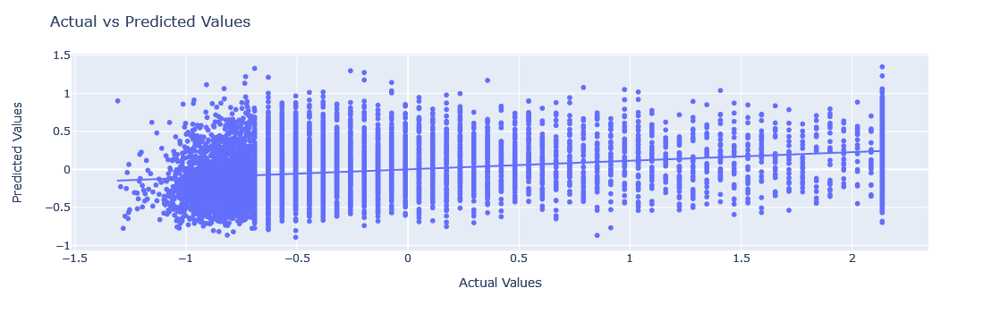

In [122]:
# Assuming y_test and ycap are defined and are of the same length
# Convert them to Pandas Series if they aren't already
data = pd.DataFrame({
    'Actual Values': y_test,
    'Predicted Values': ycap
})

# Create the scatter plot with a trendline
fig = px.scatter(data, x='Actual Values', y='Predicted Values', trendline="ols")

# Update layout with title and axis labels
fig.update_layout(
    title='Actual vs Predicted Values',
    xaxis_title='Actual Values',
    yaxis_title='Predicted Values'
)

# Show the plot
fig.show()

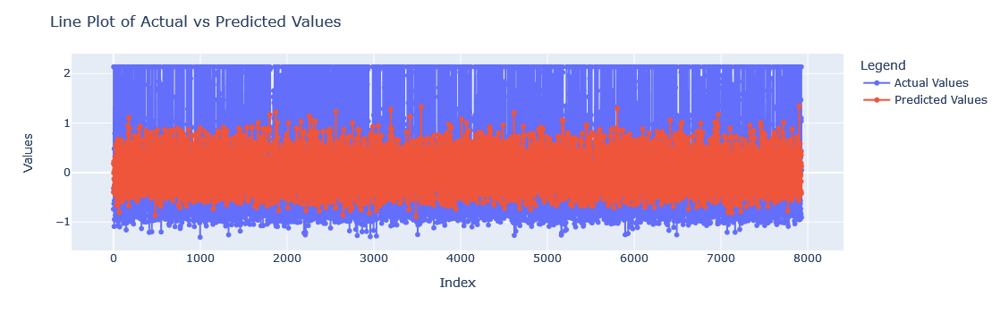

In [123]:
# Making Data Insights Interactive and Engaging with Plotly Express
data = pd.DataFrame({
    'Actual Values': y_test,
    'Predicted Values': ycap
})
data = data.reset_index()  # Reset index if needed to use it as a plot dimension

fig = px.line(data, x=data.index, y=['Actual Values', 'Predicted Values'], markers=True)
fig.update_layout(title='Line Plot of Actual vs Predicted Values',
                  xaxis_title='Index',
                  yaxis_title='Values',
                  legend_title='Legend')
fig.show()

# DecisionTree Regressor

In [124]:
from sklearn.tree import DecisionTreeRegressor
dt = DecisionTreeRegressor(random_state=0)
dt.fit(x_train,y_train)

DecisionTreeRegressor(random_state=0)

In [125]:
# Feature Importances
dt.feature_importances_

array([0.07248353, 0.03549917, 0.0580639 , 0.03702816, 0.04921481,
       0.03645726, 0.02081344, 0.01897498, 0.00998159, 0.05923258,
       0.03977758, 0.05951711, 0.12836753, 0.03256918, 0.05845636,
       0.05030711, 0.0583526 , 0.06743313, 0.06334826, 0.01911229,
       0.02500943])

In [126]:
# You can also access the tree object itself to explore more details
dt.min_samples_split

2

In [127]:
# prediction
ycap1=dt.predict(x_test)
ycap1

array([-0.75248672, -0.62910094,  2.13535754, ..., -0.44402226,
       -0.50571515, -0.50571515])

In [128]:
y_test

18765   -0.740765
16349   -0.320636
27703    2.135358
32947    2.135358
35434    2.135358
           ...   
3537     1.036607
19760    1.098300
21075    2.135358
20480   -0.906102
5914     0.049521
Name: shares, Length: 7929, dtype: float64

In [129]:
# mean squared error as metrics c1=sigma(y-y^)2/n 
from sklearn import metrics 
mse=metrics.mean_squared_error(y_test,ycap1)
rese=np.sqrt(mse)

In [130]:
mse,rese

(1.7694273966734297, 1.330198254649821)

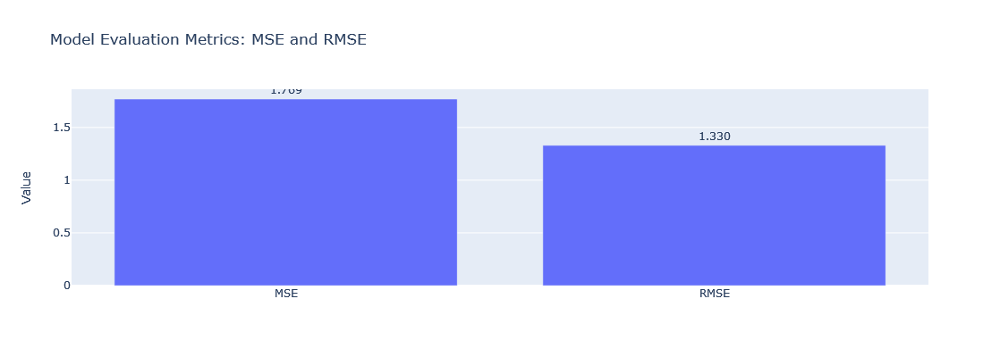

In [131]:
# Define the MSE and RMSE values
mse = 1.7694273966734297
rmse = 1.330198254649821

# Create the bar chart with both MSE and RMSE
fig = px.bar(
    x=['MSE', 'RMSE'],  # Include both MSE and RMSE in x-axis labels
    y=[mse, rmse],      # Corresponding y-axis values
    text=[f'{mse:.3f}', f'{rmse:.3f}'],  # Text annotations for both MSE and RMSE
    title="Model Evaluation Metrics: MSE and RMSE",  # Updated title
    labels={"x": "", "y": "Value"},  # Axis labels
    width=500, height=400  # Dimensions of the chart
)

# Update trace for better text display
fig.update_traces(texttemplate='%{text}', textposition='outside')

# Show the figure
fig.show()


# Scatter Plot of Actual and Predicted Values"

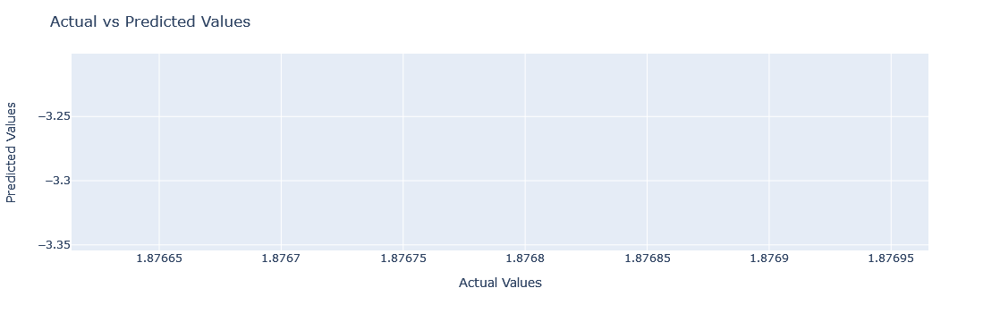

In [132]:
import plotly.express as px

# Assuming y_test and ycap1 are available as Pandas Series or they can be converted into a DataFrame
import pandas as pd
data = pd.DataFrame({
    'Actual Values': y_test,
    'Predicted Values': ycap1
})

fig = px.scatter(data, x='Actual Values', y='Predicted Values', trendline="ols")
fig.update_layout(title='Actual vs Predicted Values',
                  xaxis_title='Actual Values',
                  yaxis_title='Predicted Values')
fig.show()

# Visualizing Actual and Predicted Values with Line Plot

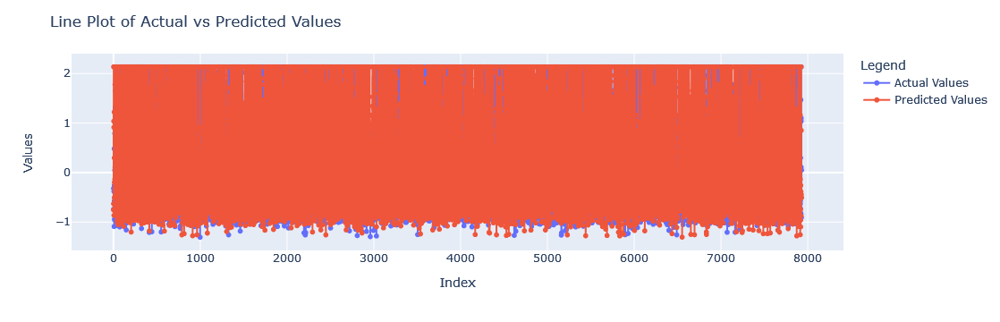

In [133]:
# Making Data Insights Interactive and Engaging with Plotly Express
data = pd.DataFrame({
    'Actual Values': y_test,
    'Predicted Values': ycap1
})
data = data.reset_index()  # Reset index if needed to use it as a plot dimension

fig = px.line(data, x=data.index, y=['Actual Values', 'Predicted Values'], markers=True)
fig.update_layout(title='Line Plot of Actual vs Predicted Values',
                  xaxis_title='Index',
                  yaxis_title='Values',
                  legend_title='Legend')
fig.show()

# RandomForestRegressor

In [146]:
# train the model 
from sklearn.ensemble import RandomForestRegressor
rf =RandomForestRegressor()
rf.fit(x_train, y_train)

RandomForestRegressor()

In [147]:
# evaluation 
y_cap2=rf.predict(x_test)

In [148]:
y_cap2

array([-0.49928059, -0.09439631,  0.24346481, ...,  0.33968105,
       -0.28819219,  0.24242837])

In [149]:
y_test

18765   -0.740765
16349   -0.320636
27703    2.135358
32947    2.135358
35434    2.135358
           ...   
3537     1.036607
19760    1.098300
21075    2.135358
20480   -0.906102
5914     0.049521
Name: shares, Length: 7929, dtype: float64

In [150]:
# Evaluate the model with regression metrics
mae = metrics.mean_absolute_error(y_test, y_cap2)
mse = metrics.mean_squared_error(y_test, y_cap2)
r2 = metrics.r2_score(y_test, y_cap2)


In [151]:
mae ,mse, r2 

(0.7481217119476289, 0.8879170576148661, 0.11864118541013224)

 Based on the satisfactory performance metrics obtained with the default hyperparameters, hyperparameter tuning was deemed unnecessary for this project.

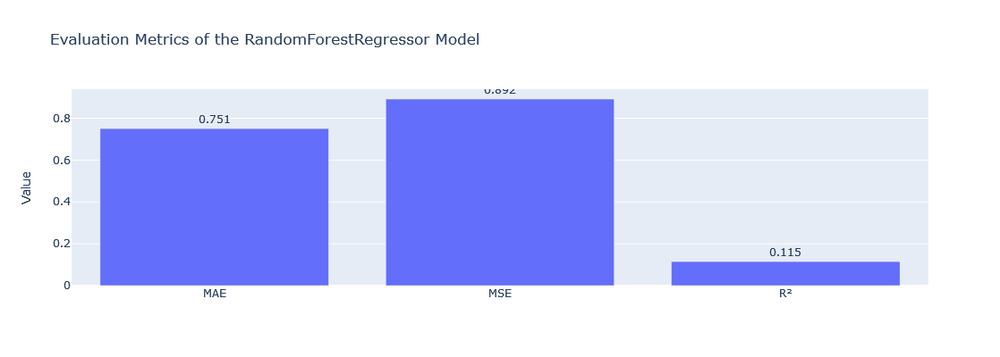

In [152]:
import plotly.express as px
# Define evaluation metrics values
mae = 0.7506699528252223
mse = 0.8916403107078148
r2 = 0.1149454326320134

# Create the bar chart
fig = px.bar(
    x=['MAE', 'MSE', 'R²'],  # Include MAE, MSE, and R² in x-axis labels
    y=[mae, mse, r2],        # Corresponding y-axis values
    text=[f'{mae:.3f}', f'{mse:.3f}', f'{r2:.3f}'],  # Text annotations for MAE, MSE, and R²
    title="Evaluation Metrics of the RandomForestRegressor Model",
    labels={"x": "", "y": "Value"},
    width=500, height=400
)

# Update trace for better text display
fig.update_traces(texttemplate='%{text}', textposition='outside')

# Show the figure
fig.show()

# Support Vector Regression 

In [154]:
from sklearn.svm import SVR
svr=SVR()
svr.fit(x_train, y_train)

SVR()

In [155]:
y_cap3=svr.predict(x_test)

In [156]:
y_cap3

array([-0.63578273, -0.41376506,  0.05995039, ..., -0.17449195,
       -0.68032776,  0.01552078])

In [157]:
y_test

18765   -0.740765
16349   -0.320636
27703    2.135358
32947    2.135358
35434    2.135358
           ...   
3537     1.036607
19760    1.098300
21075    2.135358
20480   -0.906102
5914     0.049521
Name: shares, Length: 7929, dtype: float64

In [158]:
# Evaluate the model with regression metrics
mae1 = metrics.mean_absolute_error(y_test, y_cap3)
mse1 = metrics.mean_squared_error(y_test, y_cap3)
r21 = metrics.r2_score(y_test, y_cap3)

In [159]:
mae1,mse1,r21

(0.6739174807700348, 0.9715141487296324, 0.03566155066137644)

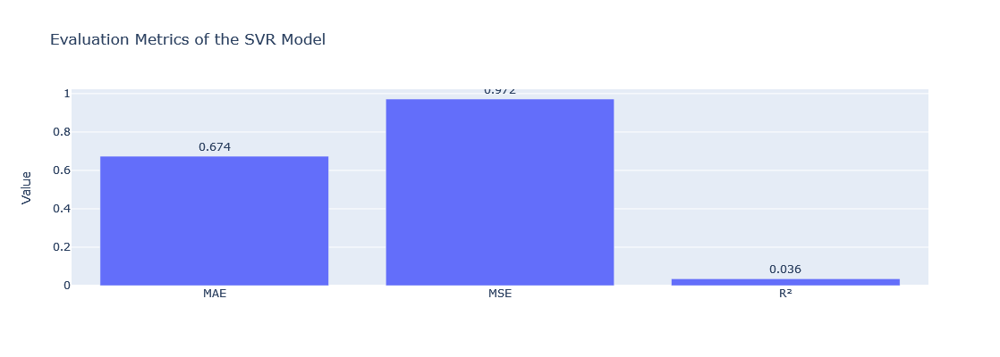

In [160]:
import plotly.express as px

# Define evaluation metrics values for SVR model
mae1 = 0.6739174807700348
mse1 = 0.9715141487296324
r21 = 0.03566155066137644

# Create the bar chart
fig = px.bar(
    x=['MAE', 'MSE', 'R²'],  # Include MAE, MSE, and R² in x-axis labels
    y=[mae1, mse1, r21],     # Corresponding y-axis values
    text=[f'{mae1:.3f}', f'{mse1:.3f}', f'{r21:.3f}'],  # Text annotations for MAE, MSE, and R²
    title="Evaluation Metrics of the SVR Model",
    labels={"x": "", "y": "Value"},
    width=500, height=400
)

# Update trace for better text display
fig.update_traces(texttemplate='%{text}', textposition='outside')

# Show the figure
fig.show()

Based on the evaluation metrics of the four models, the Linear Regression model demonstrated a relatively low RMSE, suggesting a decent fit to the data. The Decision Tree Regressor exhibited a higher RMSE, indicating potential overfitting or poor generalization. The Random Forest Regressor provided a good balance with moderate error metrics, but its R-squared value indicated limited explanation of data variability. The Support Vector Regressor achieved the lowest MAE, implying accurate predictions, but had a higher MSE and very low R-squared, indicating it did not explain the variability well. Given the satisfactory performance metrics achieved with the default hyperparameters, further hyperparameter tuning was deemed unnecessary for this project.